<a href="https://colab.research.google.com/github/judem-21/Paper-Implementations/blob/main/GAN/DCGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Import Liraries

In [ ]:
pip install pytorch-fid

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.datasets as datasets
from torch.utils.data import DataLoader
import torchvision.transforms as transforms
from torch.utils.tensorboard import SummaryWriter
import numpy as np
import matplotlib.pyplot as plt
import os
import subprocess

# Discriminator

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, channels_img, features_d):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            # Input: N X channels_img X 64 X 64
            nn.Conv2d(channels_img, features_d, kernel_size=4, stride=2, padding=1), # 32 X 32
            nn.LeakyReLU(0.2),
            self.block(features_d, features_d*2, 4, 2, 1), # 16 X 16
            self.block(features_d*2, features_d*4, 4, 2, 1), # 8 X 8
            self.block(features_d*4, features_d*8, 4, 2, 1), # 4 X 4
            nn.Conv2d(features_d*8, 1, kernel_size=4, stride=2, padding=0), # 1 X 1
            nn.Sigmoid(),
        )

    def block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding, bias=False),
                             nn.BatchNorm2d(out_channels),
                             nn.LeakyReLU(0.2))

    def forward(self, x):
        return self.disc(x)

# Generator

In [ ]:
class Generator(nn.Module):
  def __init__(self, z_dim, channels_img, features_g):
    super(Generator, self).__init__()
    self.gen = nn.Sequential(
        # Input: N X z_dim X 1 X 1
        self.block(z_dim, features_g*16, 4, 1, 0), #N X f_g*16 X 4 X 4
        self.block(features_g*16, features_g*8, 4, 2, 1), # 8 X 8
        self.block(features_g*8, features_g*4, 4, 2, 1), # 16 X 16
        self.block(features_g*4, features_g*2, 4, 2, 1), # 32 X 32
        nn.ConvTranspose2d(features_g*2, channels_img, kernel_size=4, stride=2, padding=1), # 64 X 64
        nn.Tanh(),
    )

  def block(self, in_channels, out_channels, kernel_size, stride, padding):
    return nn.Sequential(
        nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding, bias=False),
        nn.BatchNorm2d(out_channels),
        nn.ReLU(),
    )

  def forward(self, x):
    return self.gen(x)

# Initialize weights

In [ ]:
def initialize_weights(model):
  for m in model.modules():
    if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.BatchNorm2d)):
      nn.init.normal_(m.weight.data, 0.0, 0.02)

# Test

In [ ]:
def test():
  N, in_channels, H, W = 8, 3, 64, 64
  z_dim = 100
  x = torch.randn((N, in_channels, H, W))
  disc = Discriminator(in_channels, 8)
  initialize_weights(disc)
  assert disc(x).shape == (N, 1, 1, 1)
  gen = Generator(z_dim, in_channels, 8)
  initialize_weights(gen)
  z = torch.randn((N, z_dim, 1, 1))
  assert gen(z).shape == (N, in_channels, H, W)
  print("Success")

# Visualize Generated Images

In [ ]:
def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    image_tensor = (image_tensor + 1) / 2  # De-normalize the images to [0, 1] range
    image_unflat = image_tensor.detach().cpu().view(-1, *size)
    image_grid = torchvision.utils.make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

# Save Images

In [ ]:
os.makedirs('generated_images', exist_ok=True)
os.makedirs('real_images', exist_ok=True)

def save_images(images, directory, prefix, num_images=25):
    images = (images + 1) / 2  # De-normalize the images to [0, 1] range
    image_grid = torchvision.utils.make_grid(images[:num_images], nrow=5)
    image_grid = image_grid.permute(1, 2, 0).cpu().numpy() * 255
    image_filename = os.path.join(directory, f"{prefix}.png")
    plt.imsave(image_filename, image_grid.astype(np.uint8))

# Train

100%|██████████| 170498071/170498071 [00:02<00:00, 76522663.33it/s]


Extracting dataset/cifar-10-python.tar.gz to dataset/
Epoch [0/20] Batch 0/391           Loss D: 0.7007, loss G: 0.7658


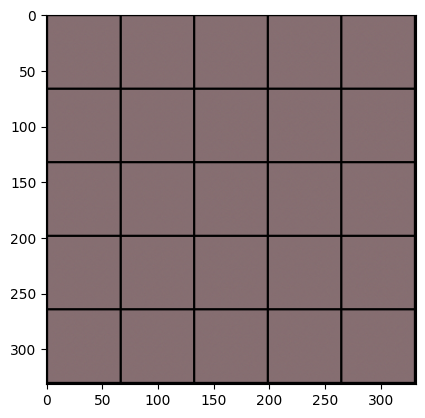

Epoch [0/20] Batch 100/391           Loss D: 0.9553, loss G: 0.6837


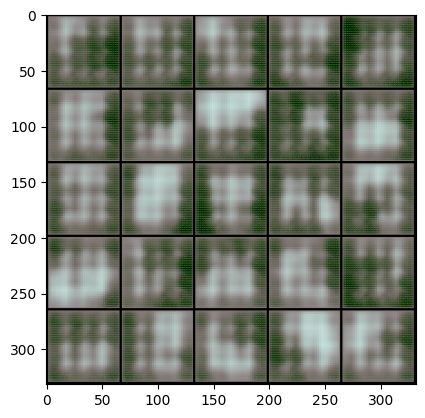

Epoch [0/20] Batch 200/391           Loss D: 0.2823, loss G: 2.4692


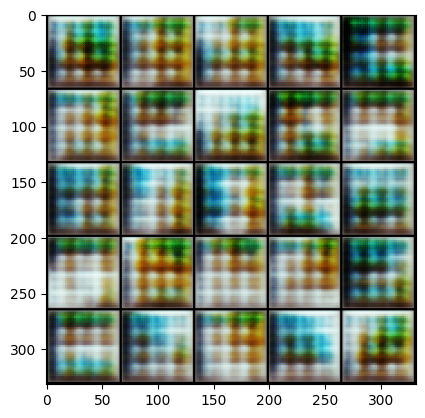

Epoch [0/20] Batch 300/391           Loss D: 0.2876, loss G: 1.4654


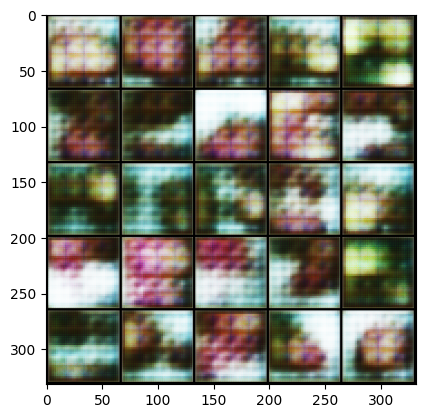

Epoch [1/20] Batch 0/391           Loss D: 0.6435, loss G: 1.7141


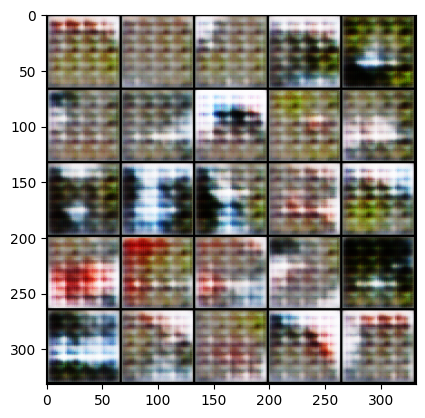

Epoch [1/20] Batch 100/391           Loss D: 0.5501, loss G: 1.1196


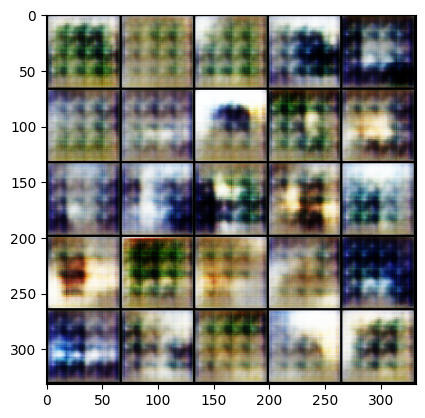

Epoch [1/20] Batch 200/391           Loss D: 0.4728, loss G: 2.0058


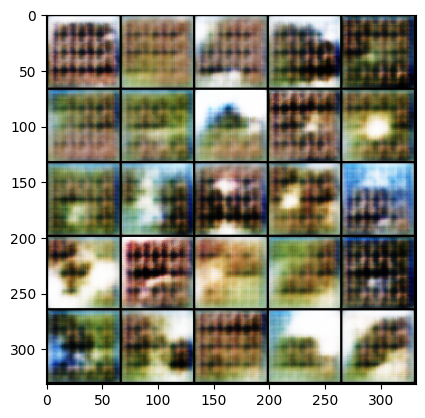

Epoch [1/20] Batch 300/391           Loss D: 0.5674, loss G: 1.8116


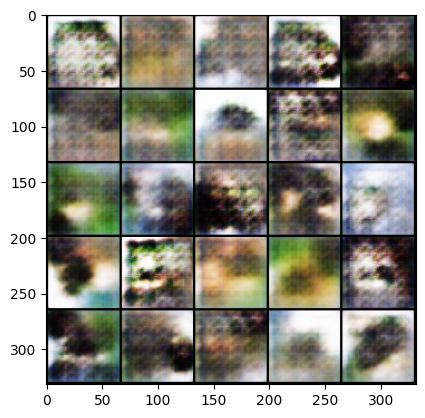

Epoch [2/20] Batch 0/391           Loss D: 0.5084, loss G: 1.2701


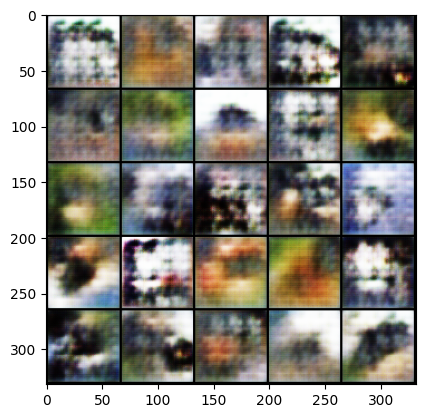

Epoch [2/20] Batch 100/391           Loss D: 0.5840, loss G: 1.4695


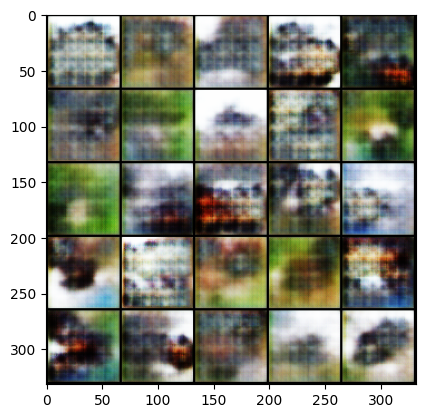

Epoch [2/20] Batch 200/391           Loss D: 0.5208, loss G: 1.6529


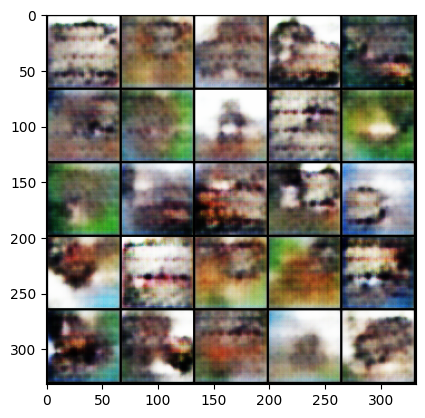

Epoch [2/20] Batch 300/391           Loss D: 0.6392, loss G: 1.2377


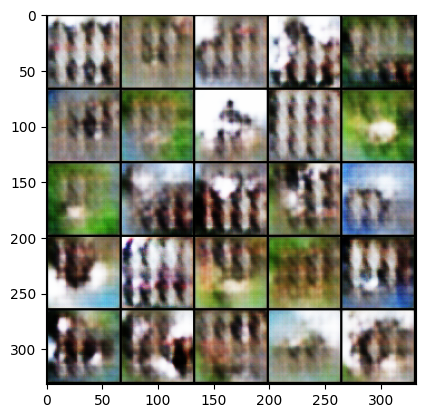

Epoch [3/20] Batch 0/391           Loss D: 0.4767, loss G: 1.5324


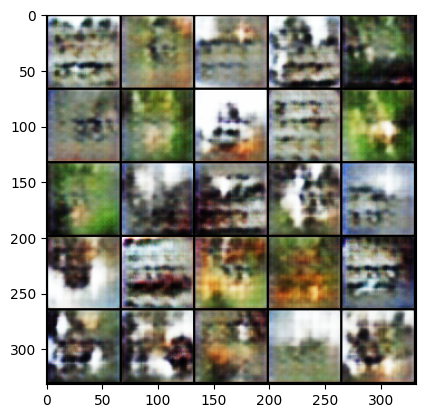

Epoch [3/20] Batch 100/391           Loss D: 0.5117, loss G: 1.2528


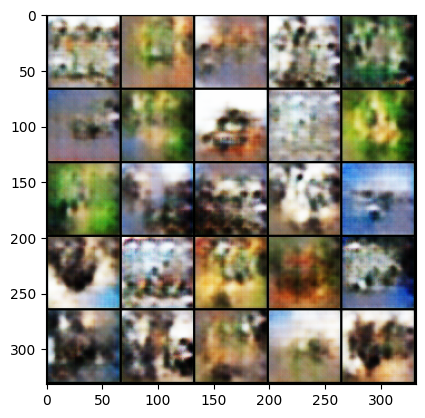

Epoch [3/20] Batch 200/391           Loss D: 0.5163, loss G: 1.1133


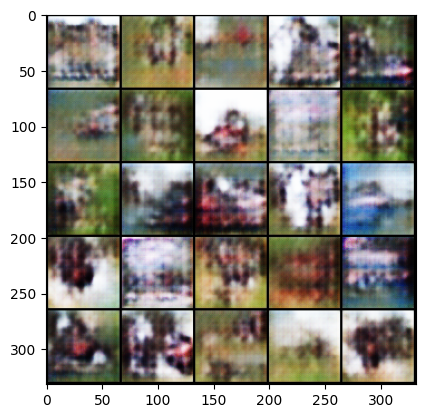

Epoch [3/20] Batch 300/391           Loss D: 0.5432, loss G: 1.0682


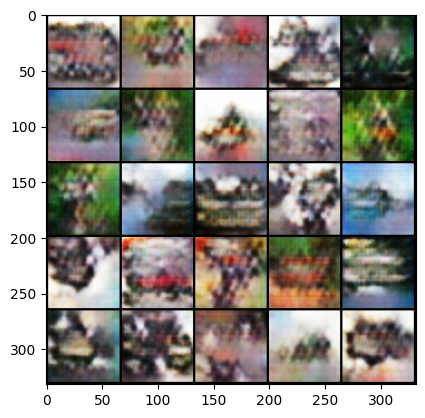

Epoch [4/20] Batch 0/391           Loss D: 0.4803, loss G: 1.1671


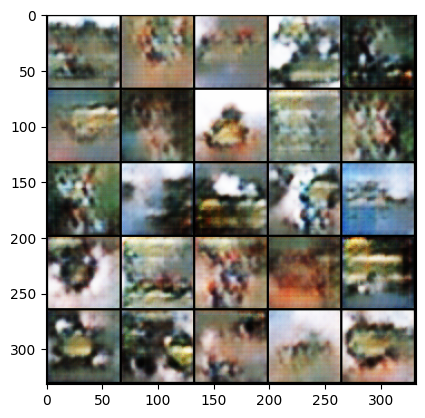

Epoch [4/20] Batch 100/391           Loss D: 0.5380, loss G: 0.9654


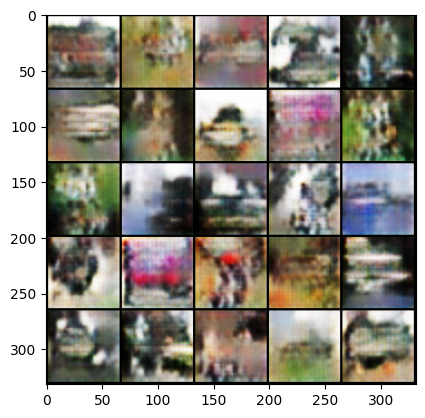

Epoch [4/20] Batch 200/391           Loss D: 0.4732, loss G: 1.6296


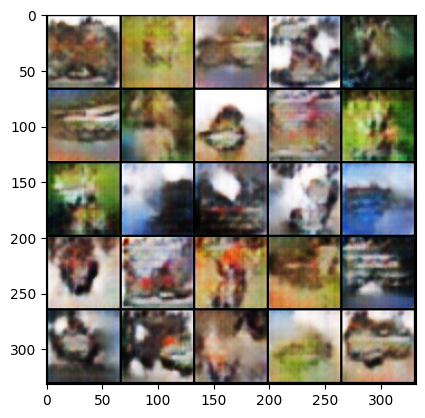

Epoch [4/20] Batch 300/391           Loss D: 0.4880, loss G: 2.6715


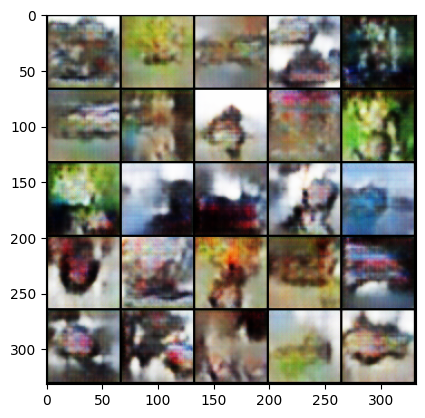

Epoch [5/20] Batch 0/391           Loss D: 0.8000, loss G: 1.0361


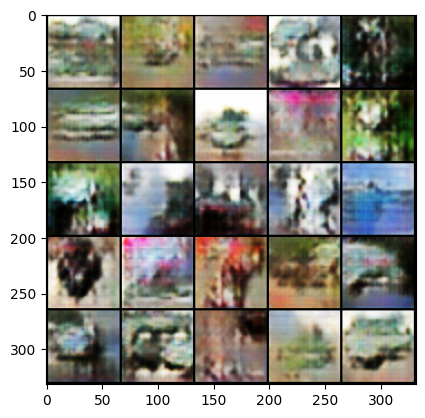

Epoch [5/20] Batch 100/391           Loss D: 0.2412, loss G: 1.6788


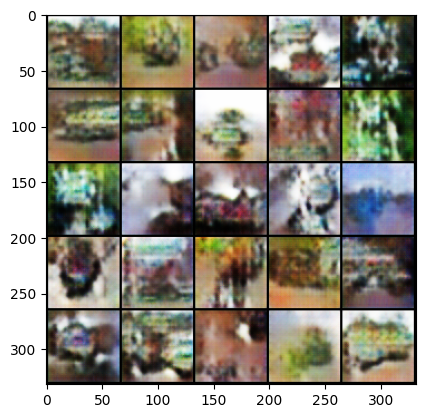

Epoch [5/20] Batch 200/391           Loss D: 0.2501, loss G: 1.9221


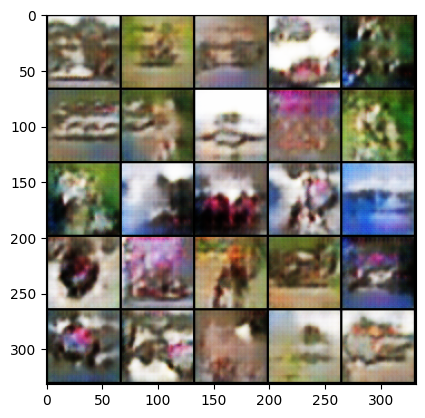

Epoch [5/20] Batch 300/391           Loss D: 0.5316, loss G: 1.4457


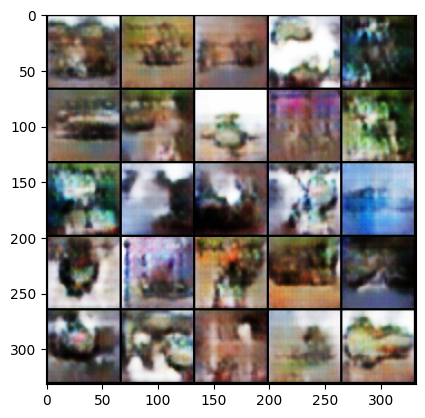

Epoch [6/20] Batch 0/391           Loss D: 0.3682, loss G: 2.0851


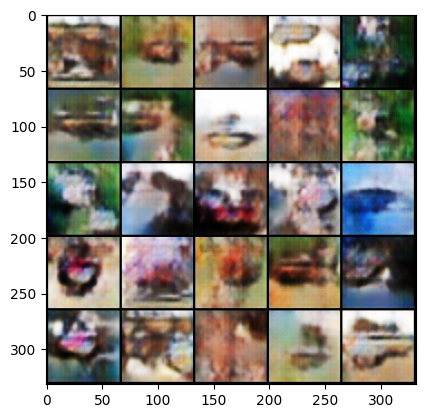

Epoch [6/20] Batch 100/391           Loss D: 1.1270, loss G: 0.9539


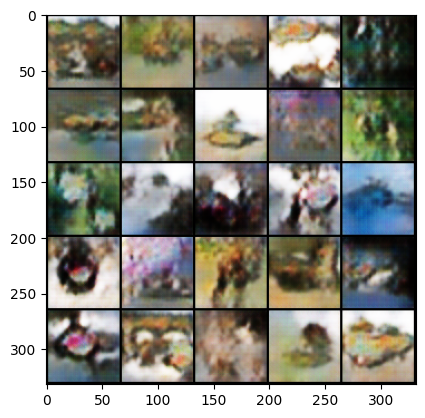

Epoch [6/20] Batch 200/391           Loss D: 0.2511, loss G: 2.7952


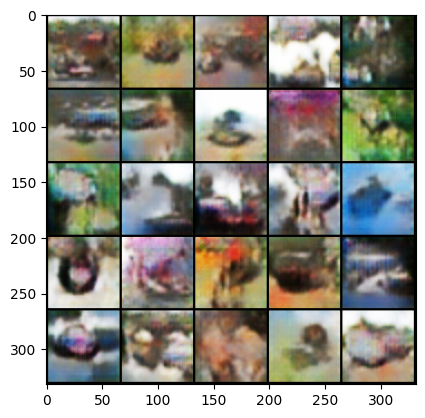

Epoch [6/20] Batch 300/391           Loss D: 0.4717, loss G: 1.3621


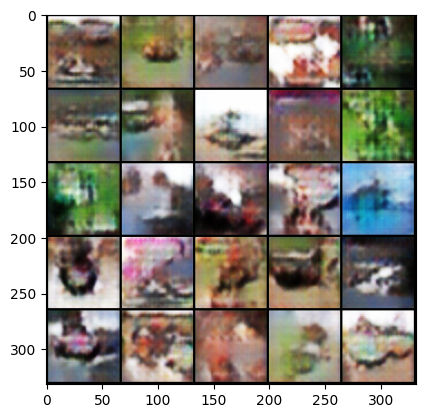

Epoch [7/20] Batch 0/391           Loss D: 0.1941, loss G: 2.2898


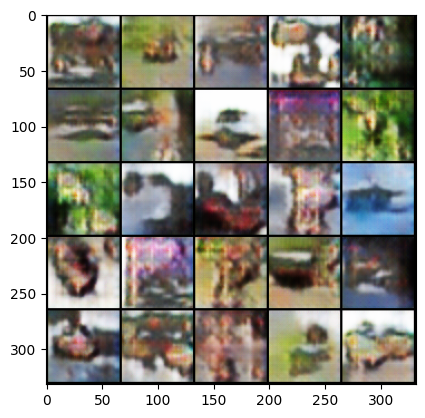

Epoch [7/20] Batch 100/391           Loss D: 0.1062, loss G: 2.8958


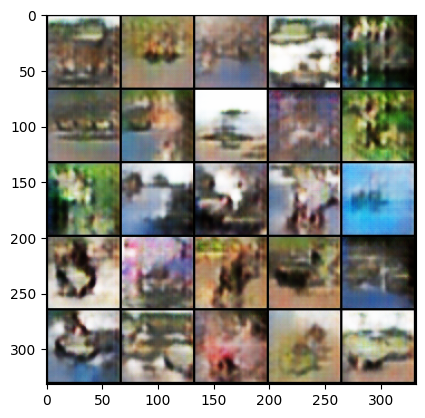

Epoch [7/20] Batch 200/391           Loss D: 0.7958, loss G: 1.3775


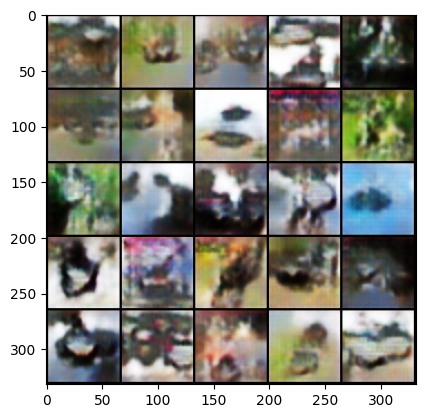

Epoch [7/20] Batch 300/391           Loss D: 0.1259, loss G: 2.9632


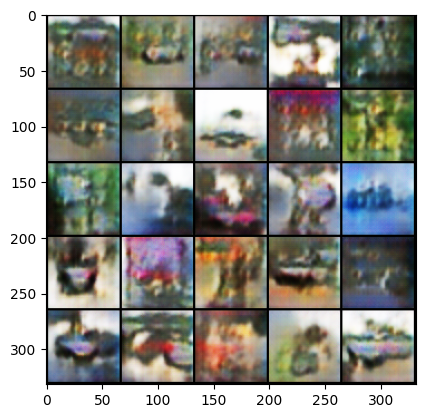

Epoch [8/20] Batch 0/391           Loss D: 0.4436, loss G: 1.7603


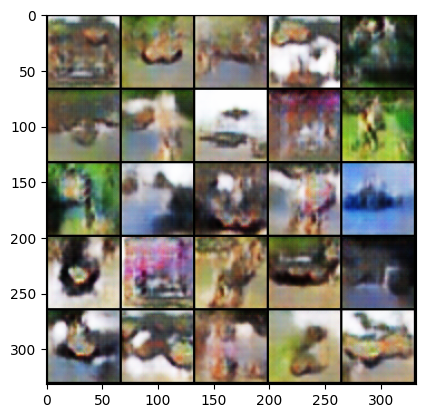

Epoch [8/20] Batch 100/391           Loss D: 0.1950, loss G: 3.4574


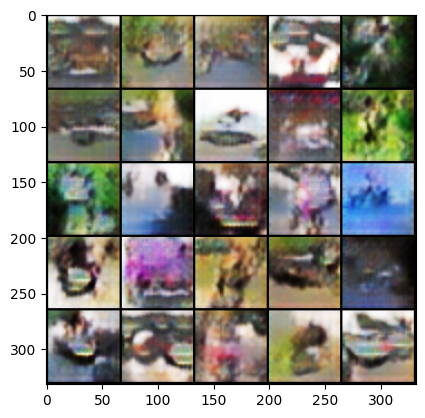

Epoch [8/20] Batch 200/391           Loss D: 0.0848, loss G: 3.3400


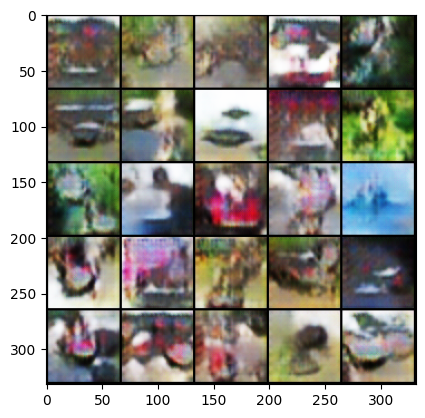

Epoch [8/20] Batch 300/391           Loss D: 0.0503, loss G: 3.7141


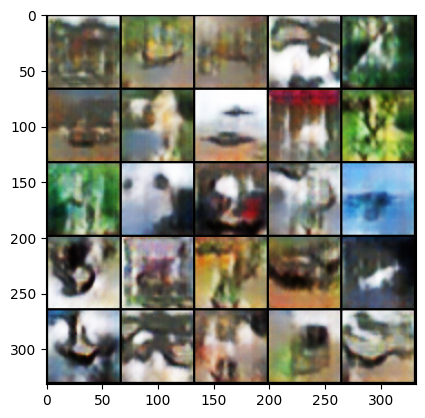

Epoch [9/20] Batch 0/391           Loss D: 0.4380, loss G: 2.1763


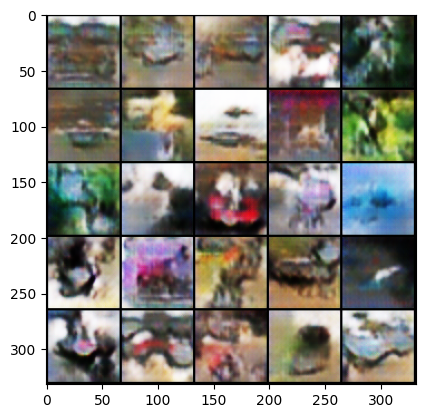

Epoch [9/20] Batch 100/391           Loss D: 1.4245, loss G: 7.2901


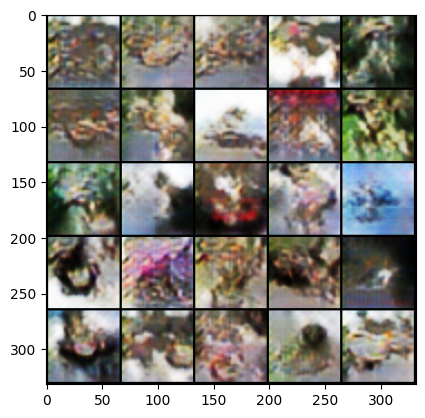

Epoch [9/20] Batch 200/391           Loss D: 0.4838, loss G: 1.5246


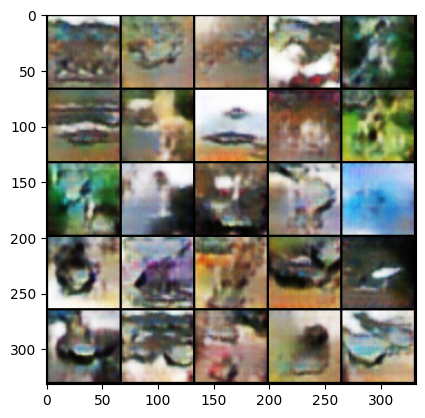

Epoch [9/20] Batch 300/391           Loss D: 0.4052, loss G: 2.5674


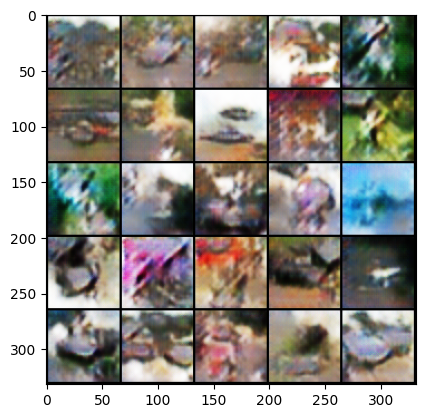

Epoch [10/20] Batch 0/391           Loss D: 0.4073, loss G: 1.9140


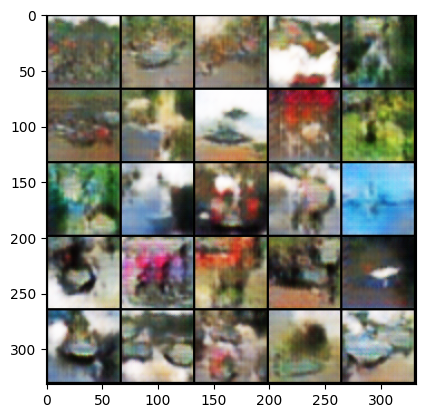

Epoch [10/20] Batch 100/391           Loss D: 0.0254, loss G: 4.0225


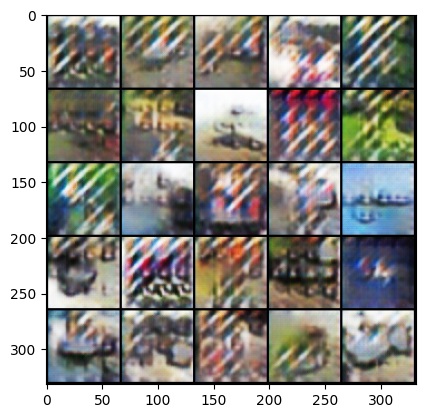

Epoch [10/20] Batch 200/391           Loss D: 0.2039, loss G: 3.0891


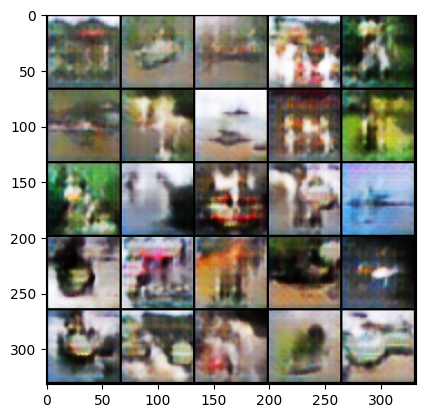

Epoch [10/20] Batch 300/391           Loss D: 0.0861, loss G: 3.3339


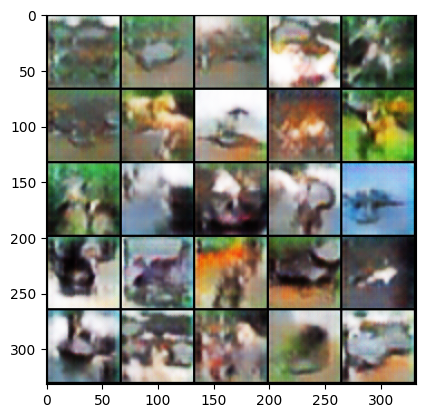

Epoch [11/20] Batch 0/391           Loss D: 0.0242, loss G: 4.3298


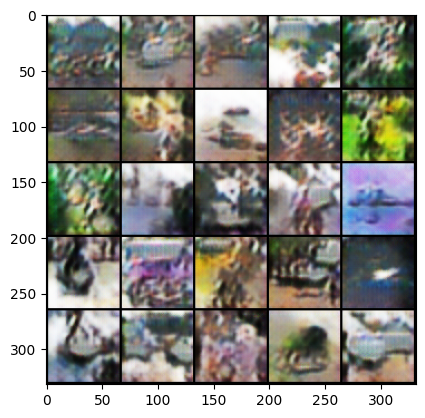

Epoch [11/20] Batch 100/391           Loss D: 0.0155, loss G: 4.1958


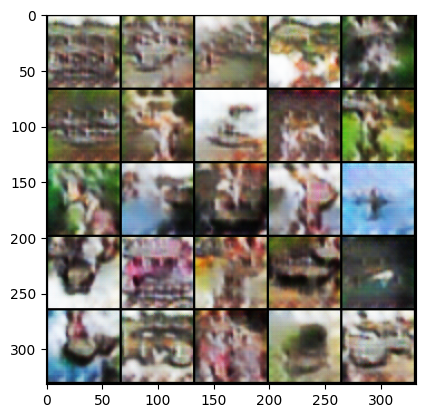

Epoch [11/20] Batch 200/391           Loss D: 0.3217, loss G: 1.6563


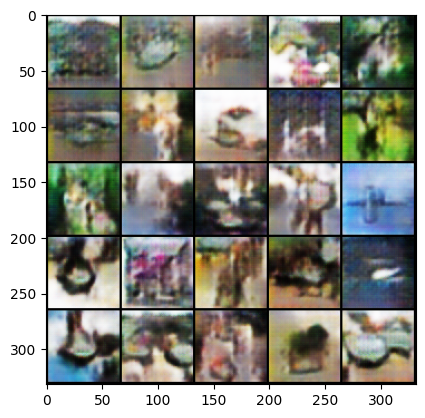

Epoch [11/20] Batch 300/391           Loss D: 0.0463, loss G: 3.5073


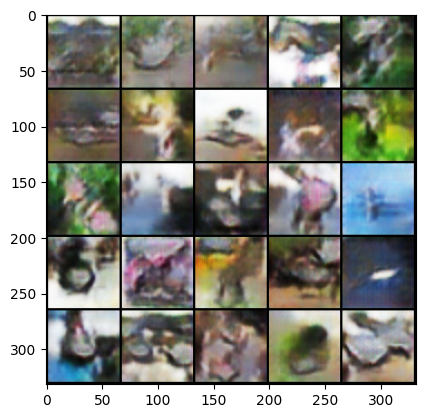

Epoch [12/20] Batch 0/391           Loss D: 0.0212, loss G: 4.2567


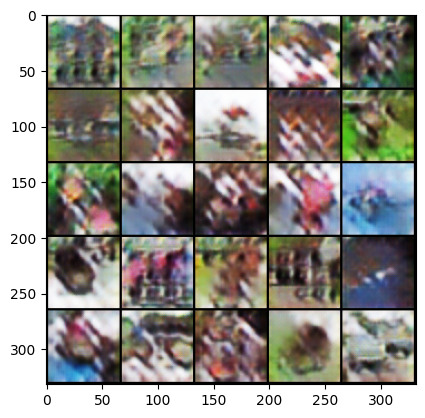

Epoch [12/20] Batch 100/391           Loss D: 0.0233, loss G: 5.2437


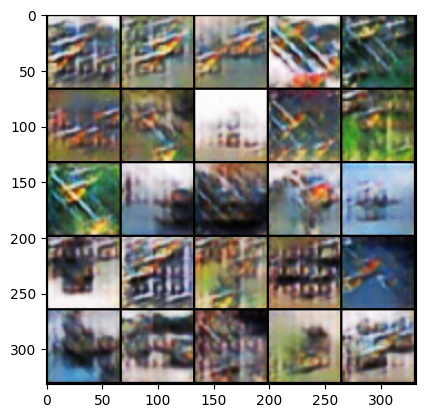

Epoch [12/20] Batch 200/391           Loss D: 0.1438, loss G: 3.1278


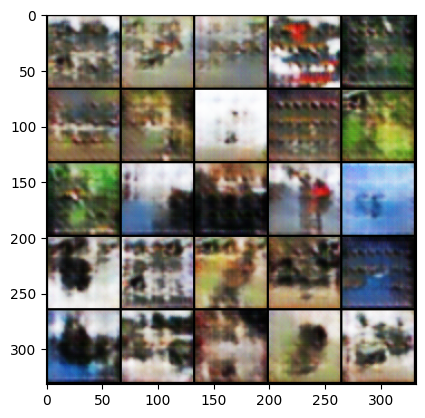

Epoch [12/20] Batch 300/391           Loss D: 0.0918, loss G: 3.2822


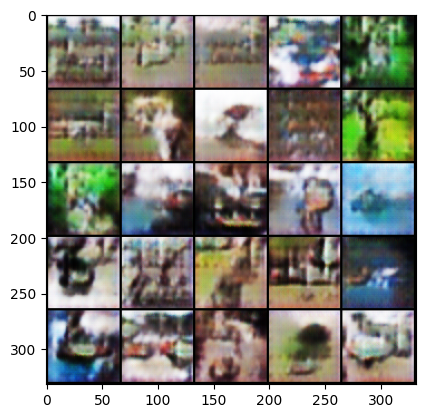

Epoch [13/20] Batch 0/391           Loss D: 0.0852, loss G: 3.5677


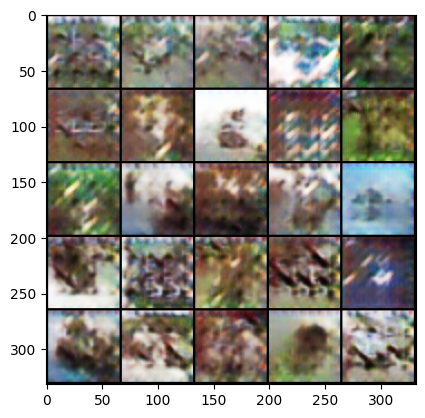

Epoch [13/20] Batch 100/391           Loss D: 0.1806, loss G: 3.9945


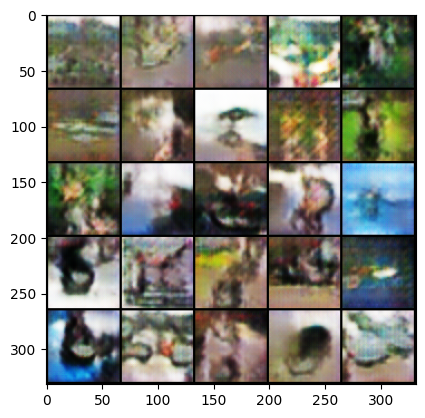

Epoch [13/20] Batch 200/391           Loss D: 0.1657, loss G: 4.0500


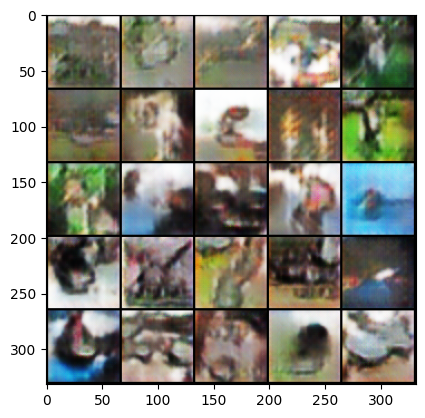

Epoch [13/20] Batch 300/391           Loss D: 0.2424, loss G: 2.1890


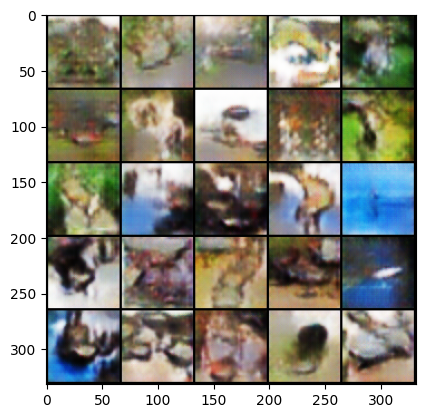

Epoch [14/20] Batch 0/391           Loss D: 0.0139, loss G: 5.1789


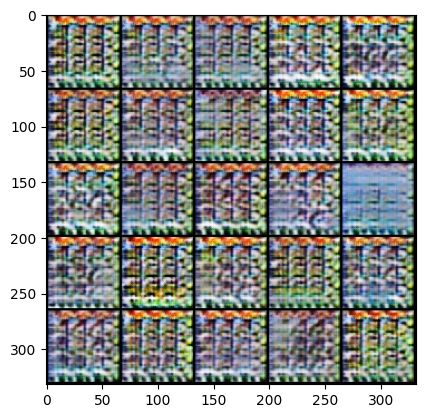

Epoch [14/20] Batch 100/391           Loss D: 0.0030, loss G: 6.0585


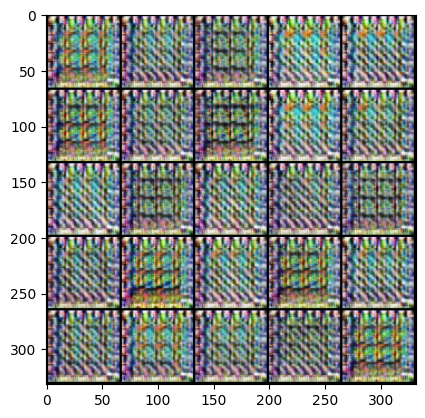

Epoch [14/20] Batch 200/391           Loss D: 0.0057, loss G: 5.3180


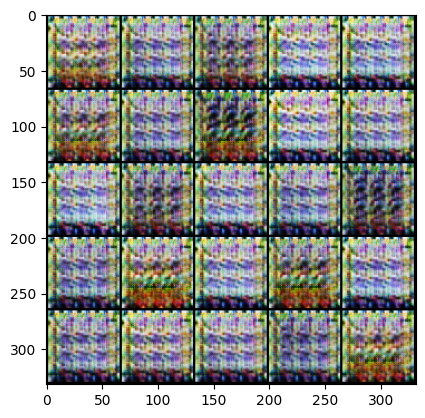

Epoch [14/20] Batch 300/391           Loss D: 0.0011, loss G: 7.7738


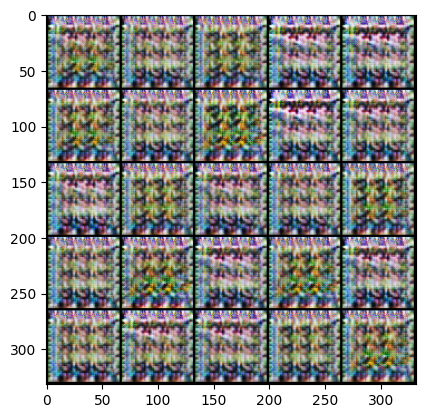

Epoch [15/20] Batch 0/391           Loss D: 0.0018, loss G: 6.4714


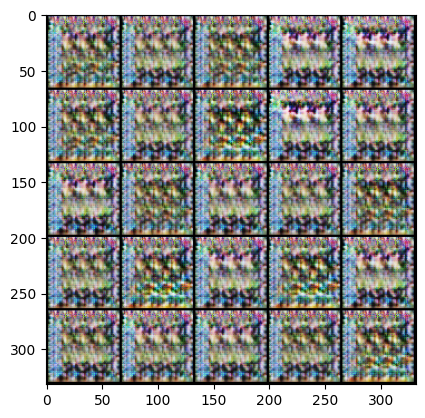

Epoch [15/20] Batch 100/391           Loss D: 0.0005, loss G: 8.6377


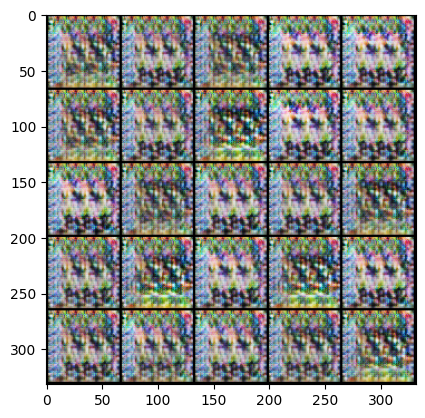

Epoch [15/20] Batch 200/391           Loss D: 0.0023, loss G: 7.6752


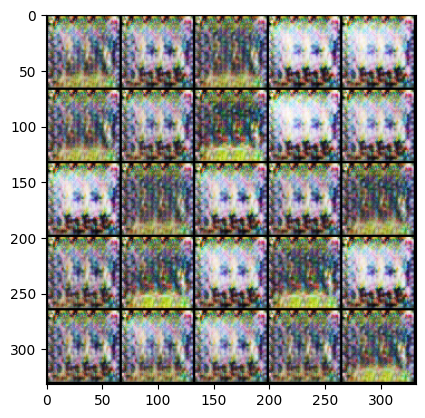

KeyboardInterrupt: 

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
lr = 2e-4
batch_size = 128
image_size = 64
channels_img = 3
z_dim = 100
num_epochs = 14
features_disc = 64
features_gen = 64

image_transforms = transforms.Compose(
    [
     transforms.Resize(image_size),
     transforms.ToTensor(),
     transforms.Normalize([0.5 for _ in range(channels_img)], [0.5 for _ in range(channels_img)]),
    ]
)

dataset = datasets.CIFAR10(root = "dataset/", train=True, transform=image_transforms, download=True)
loader = DataLoader(dataset, batch_size=batch_size, shuffle=True)
gen = Generator(z_dim, channels_img, features_gen).to(device)
disc = Discriminator(channels_img, features_disc).to(device)
initialize_weights(gen)
initialize_weights(disc)

opt_gen = optim.Adam(gen.parameters(), lr=lr, betas=(0.5, 0.999))
opt_disc = optim.Adam(disc.parameters(), lr=lr, betas=(0.5, 0.999))
criterion = nn.BCELoss()

fixed_noise = torch.randn(32, z_dim, 1, 1).to(device)
writer_real = SummaryWriter(f"logs/real")
writer_fake = SummaryWriter(f"logs/fake")
step = 0

gen.train()
disc.train()

gen_losses = []
disc_losses = []
iterations = []

for epoch in range(num_epochs):
  for batch_idx, (real, _) in enumerate(loader):
    real = real.to(device)
    noise = torch.randn((batch_size, z_dim, 1, 1)).to(device)
    fake = gen(noise)

    # Train Discriminator max log(D(x)) + log(1-d(G(z)))
    disc_real = disc(real).reshape(-1)
    loss_disc_real = criterion(disc_real, torch.ones_like(disc_real))
    disc_fake = disc(fake).reshape(-1)
    loss_disc_fake = criterion(disc_fake, torch.zeros_like(disc_fake))
    loss_disc = (loss_disc_real + loss_disc_fake) / 2
    disc.zero_grad()
    loss_disc.backward(retain_graph=True)
    opt_disc.step()

    #Train Generator min log(1-D(G(z))) <-> max log(D(G(Z)))
    output = disc(fake).reshape(-1)
    loss_gen = criterion(output, torch.ones_like(output))
    gen.zero_grad()
    loss_gen.backward()
    opt_gen.step()

    gen_losses.append(loss_gen.item())
    disc_losses.append(loss_disc.item())
    iterations.append(epoch * len(loader) + batch_idx)

    #Print losses occassionally
    if batch_idx % 100 == 0:
      print(
          f"Epoch [{epoch}/{num_epochs}] Batch {batch_idx}/{len(loader)} \
          Loss D: {loss_disc:.4f}, loss G: {loss_gen:.4f}"
      )

      with torch.no_grad():
        fake = gen(fixed_noise)
        img_grid_real = torchvision.utils.make_grid(real[:32], normalize=True)
        img_grid_fake = torchvision.utils.make_grid(fake[:32], normalize=True)

        writer_real.add_image("Real", img_grid_real, global_step=step)
        writer_fake.add_image("Fake", img_grid_fake, global_step=step)

        save_images(real.cpu(), 'real_images', f'real_epoch_{epoch}_batch_{batch_idx}')
        save_images(fake.cpu(), 'generated_images', f'fake_epoch_{epoch}_batch_{batch_idx}')

        show_tensor_images(fake, num_images=25, size=(channels_img, image_size, image_size))

      step += 1

# Calculate Frechet Inception Distance

In [ ]:
def compute_fid(real_images_dir, fake_images_dir):
    # Call the FID computation from the command line
    result = subprocess.run([
        'python', '-m', 'pytorch_fid', real_images_dir, fake_images_dir
    ], capture_output=True, text=True)

    # Parse and print FID score
    fid_score_line = [line for line in result.stdout.split('\n') if 'FID' in line]
    if fid_score_line:
        fid_score = fid_score_line[0].split()[-1]
        print(f"FID Score: {fid_score}")

def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

# Number of parameters in the Generator
gen_params = count_parameters(gen)
print(f"Generator has {gen_params:,} trainable parameters")

# Number of parameters in the Discriminator
disc_params = count_parameters(disc)
print(f"Discriminator has {disc_params:,} trainable parameters")

# Call this function after training
compute_fid('real_images', 'generated_images')

Generator has 12,658,435 trainable parameters
Discriminator has 2,765,633 trainable parameters
FID Score: 270.6898393061747


# Plot Losses

In [ ]:
plt.figure(figsize=(12, 6))
plt.plot(iterations, gen_losses, label='Generator Loss')
plt.plot(iterations, disc_losses, label='Discriminator Loss')
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.title('Generator and Discriminator Losses')
plt.legend()
plt.show()